In [43]:
import os
import typing as tp

from PIL import Image
from collections import defaultdict

from pathlib import Path
import pandas as pd
import numpy as np
import torch

import torch.nn as nn
import torch.nn.functional as F

import torchvision
import torchvision.transforms as T

from sklearn.model_selection import train_test_split

from sklearn.metrics import f1_score, recall_score, precision_score, accuracy_score

from torch.utils.data import Dataset, DataLoader


from tqdm import trange

# Constants

In [44]:
BATCH_SIZE = 16


DATA_ROOT = Path("./data/")

MARKUP_DATA = DATA_ROOT / "markup"
NO_MARKUP_DATA = DATA_ROOT / "no_markup"

LABEL_COL = "is_conifer"
URL_COL = "downloadUrl"
PATH_COL = "image_path"

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Datasets basic files 

In [45]:
def read_dataframe(path: str, data_root: Path):
    """
    Load the dataframe and get images paths on the machine, transform labels to float values
    """
    df = pd.read_csv(path, sep="\t")
    df[PATH_COL] = df[URL_COL].apply(lambda x: str(data_root / os.path.basename(x)))
    try:
        df[LABEL_COL] = df[LABEL_COL].astype(float)
    except KeyError:  #  placeholder for absent label column
        df[LABEL_COL] = None
    return df

In [46]:
markup_df = read_dataframe(path="./hw_3_markup_data.txt", data_root=MARKUP_DATA)
markup_df.head()

,is_conifer,downloadUrl,image_path
0,1.0,https://new-projects-team-public.s3.yandex.net...,data/markup/0101000020E6100000FABC6D9C10DC4240...
1,0.0,https://new-projects-team-public.s3.yandex.net...,data/markup/0101000020E6100000A54749CB65CB4240...
2,1.0,https://new-projects-team-public.s3.yandex.net...,data/markup/0101000020E6100000FAEF4A5D75513E40...
3,0.0,https://new-projects-team-public.s3.yandex.net...,data/markup/0101000020E6100000A5557106A6B44240...
4,0.0,https://new-projects-team-public.s3.yandex.net...,data/markup/0101000020E6100000A535CEF231BD4240...


In [47]:
# TODO label the data
labeled_df = read_dataframe("./hw_3_no_markup_data.txt", data_root=NO_MARKUP_DATA)
labeled_df.head()

,downloadUrl,image_path,is_conifer
0,https://new-projects-team-public.s3.yandex.net...,data/no_markup/0101000020E61000009D8371B486563...,None
1,https://new-projects-team-public.s3.yandex.net...,data/no_markup/0101000020E61000007E55541BA1CD4...,None
2,https://new-projects-team-public.s3.yandex.net...,data/no_markup/0101000020E6100000C9303D4DA5D64...,None
3,https://new-projects-team-public.s3.yandex.net...,data/no_markup/0101000020E6100000D196F4A983DB4...,None
4,https://new-projects-team-public.s3.yandex.net...,data/no_markup/0101000020E6100000E390685D7ECC4...,None


# Dataset and dataloaders

In [48]:
class ImageClassificationDataset(Dataset):
    def __init__(self, base_dataframe: pd.DataFrame, transform = None):
        _filenames: list[str] = base_dataframe[PATH_COL].values.tolist()

        self.transform = transform

        self._labels: torch.Tensor = torch.from_numpy(base_dataframe[LABEL_COL].values).unsqueeze(1)
        self._images: list[Image] = [Image.open(path).convert("RGB") for path in _filenames]


    def __len__(self):
        return len(self._labels)

    def __getitem__(self, idx):
        label = self._labels[idx]
        image = self._images[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

train_transform = T.Compose([
    T.Resize((128, 128)),
    T.RandomHorizontalFlip(),
    # T.RandomRotation(5),
    T.ToTensor(),
    T.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

test_transform = T.Compose([
    T.Resize((128, 128)),
    T.ToTensor(),
    T.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])


In [49]:
train_df, test_df = train_test_split(markup_df, random_state=42, stratify=markup_df[LABEL_COL])

val_df, test_df = train_test_split(test_df, random_state=42)

In [50]:
train_dataset = ImageClassificationDataset(base_dataframe=train_df, transform=train_transform)
val_dataset = ImageClassificationDataset(base_dataframe=val_df, transform=test_transform)
test_dataset = ImageClassificationDataset(base_dataframe=test_df, transform=test_transform)


train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=12, prefetch_factor=4)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=12, prefetch_factor=4)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=12, prefetch_factor=4)

In [51]:
def get_model(model_type: tp.Literal["resnet18", "resnet50", "resnet152"] = "resnet152",
              pretrained: bool = True, last_embedding_layer: bool = False):
    if model_type == "resnet18":
        model = torchvision.models.resnet18(weights=torchvision.models.ResNet18_Weights.IMAGENET1K_V1)
        model.fc = nn.Linear(model.fc.in_features, 1) if not last_embedding_layer else nn.Identity()
    elif model_type == "resnet50":
        model = torchvision.models.resnet50(weights=torchvision.models.ResNet50_Weights.IMAGENET1K_V2)
        model.fc = nn.Linear(model.fc.in_features, 1) if not last_embedding_layer else nn.Identity()
    elif model_type == "resnet152":
        model = torchvision.models.resnet152(weights=torchvision.models.ResNet152_Weights.IMAGENET1K_V2)
        model.fc = nn.Linear(model.fc.in_features, 1) if not last_embedding_layer else nn.Identity()
    else:
        raise NotImplementedError(f"Model {model_type} is not supported")

    
    model = model.to(DEVICE)
    return model


In [52]:
def compute_metrics(y_pred: torch.Tensor, y_true: torch.Tensor):
    y_pred = y_pred.detach().cpu().tolist()
    y_true = y_true.detach().cpu().tolist()

    return dict(
        f1=f1_score(y_true=y_true, y_pred=y_pred).item(),
        precision=precision_score(y_true=y_true, y_pred=y_pred).item(),
        recall=recall_score(y_true=y_true, y_pred=y_pred).item(),
        accuracy=accuracy_score(y_true=y_true, y_pred=y_pred),
    )

In [53]:
def train_epoch(model, optimizer, criterion, train_loader):

    model.train()
    total_loss = 0.0
    predictions = []
    true_labels = []

    for images, labels in train_loader:
        images, labels = images.to(DEVICE), labels.to(DEVICE)
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        total_loss += loss.detach()

        predictions.append((outputs > 0).cpu().long().flatten())
        true_labels.append(labels.cpu().long().flatten())
        
    predictions = torch.cat(predictions)
    true_labels = torch.cat(true_labels)

    mean_epoch_loss = total_loss.item() / len(train_loader)
    report = compute_metrics(y_pred=predictions, y_true=true_labels)

    return mean_epoch_loss, report

@torch.inference_mode()
def eval_epoch(model, criterion, val_or_test_loader, return_predictions=False):
    model.eval()

    total_loss = 0.0
    predictions = []
    true_labels = []
    scores = []


    for images, labels in val_or_test_loader:
        images, labels = images.to(DEVICE), labels.to(DEVICE)
        outputs = model(images)

        loss = criterion(outputs, labels)

        total_loss += loss.detach()
    
        predictions.append((outputs > 0).cpu().long().flatten())
        scores.append(outputs.detach().cpu().flatten())

        true_labels.append(labels.cpu().long().flatten())
        
    predictions = torch.cat(predictions)
    true_labels = torch.cat(true_labels)
    scores = torch.cat(scores)
    
    mean_epoch_loss = total_loss.item() / len(val_or_test_loader)
    report = compute_metrics(y_pred=predictions, y_true=true_labels)
    if return_predictions:
        return mean_epoch_loss, report, predictions, scores
    return mean_epoch_loss, report



In [54]:
def train_and_evaluate(model,
                       train_loader,
                       val_loader,
                       test_loader,
                       optimizer,
                       optimizer_parameters,
                       criterion,
                       num_epochs) -> tp.Any:
    criterion = nn.BCEWithLogitsLoss()
    optimizer = torch.optim.AdamW(model.parameters(), **optimizer_parameters)


    train_losses = []
    val_losses = []

    train_reports = []
    val_reports = []

    best_val_f1 = 0
    best_acc = 0
    best_weights = model.state_dict()
    best_epoch = -1

    tk = trange(1, num_epochs + 1)


    for epoch in tk:
        train_epoch_loss, train_report = train_epoch(model=model, optimizer=optimizer, criterion=criterion, train_loader=train_loader)


        val_epoch_loss, val_report = eval_epoch(model=model, criterion=criterion, val_or_test_loader=val_loader)

        if (val_f1 := val_report["f1"]) > best_val_f1:
            best_val_f1 = val_f1
            best_weights = model.state_dict()
            best_epoch = epoch
    
        report_dict = {
            "Epoch": str(epoch),
            "Train loss": "%6f" % float(train_epoch_loss),
            "Val loss": "%6f" % float(val_epoch_loss),

            "Val F1": "%6f" % val_f1,
            "Val Acc": "%6f" % val_report["f1"],

            "Best Val F1": "%6f" % best_val_f1,
            "Best Val Epoch": "%6d" % best_epoch,

        }
        
        tk.set_postfix(report_dict)

        train_losses.append(train_epoch_loss)
        val_losses.append(val_epoch_loss)
        train_reports.append(train_report)
        val_reports.append(val_report)


    model.load_state_dict(best_weights)
    if test_loader is not None:
        test_loss, test_report = eval_epoch(model=model, criterion=criterion, val_or_test_loader=test_loader)
    else:
        test_loss, test_report = None, None


    train_reports_accumulated = defaultdict(list)
    val_reports_accumulated = defaultdict(list)

    for report in train_reports:
        for metric, value in report.items():
            train_reports_accumulated[metric].append(value)

    for report in val_reports:
        for metric, value in report.items():
            val_reports_accumulated[metric].append(value)

    return train_losses, train_reports_accumulated, val_losses, val_reports_accumulated, test_loss, test_report, best_weights


In [55]:
model = get_model(model_type="resnet18")


optimizer = torch.optim.AdamW
optimizer_parameters = dict(
    lr=0.001
)
criterion = nn.BCEWithLogitsLoss()


(train_losses, train_reports,
 val_losses, val_reports,
 test_loss, test_report, best_weights) = train_and_evaluate(model=model,
                                              train_loader=train_loader,
                                              val_loader=val_loader,
                                              test_loader=test_loader,
                                              optimizer=optimizer,
                                              optimizer_parameters=optimizer_parameters,
                                              criterion=criterion,
                                              num_epochs=10)
del model
torch.cuda.empty_cache()
test_report

100%|██████████| 10/10 [00:30<00:00,  3.10s/it, Epoch=10, Train loss=0.277696, Val loss=0.466793, Val F1=0.790698, Val Acc=0.790698, Best Val F1=0.809524, Best Val Epoch=8]


{'f1': 0.6153846153846154,
 'precision': 0.5,
 'recall': 0.8,
 'accuracy': 0.6153846153846154}

In [56]:
model = get_model(model_type="resnet50")


optimizer = torch.optim.AdamW
optimizer_parameters = dict(
    lr=0.001
)
criterion = nn.BCEWithLogitsLoss()


(train_losses, train_reports,
 val_losses, val_reports,
 test_loss, test_report, best_weights) = train_and_evaluate(model=model,
                                              train_loader=train_loader,
                                              val_loader=val_loader,
                                              test_loader=test_loader,
                                              optimizer=optimizer,
                                              optimizer_parameters=optimizer_parameters,
                                              criterion=criterion,
                                              num_epochs=10)
del model
torch.cuda.empty_cache()
test_report

  0%|          | 0/10 [00:00<?, ?it/s]

100%|██████████| 10/10 [00:32<00:00,  3.27s/it, Epoch=10, Train loss=0.707584, Val loss=0.673003, Val F1=0.744186, Val Acc=0.744186, Best Val F1=0.760000, Best Val Epoch=8]


{'f1': 0.7272727272727273,
 'precision': 0.6666666666666666,
 'recall': 0.8,
 'accuracy': 0.7692307692307693}

In [57]:
model = get_model(model_type="resnet152")


optimizer = torch.optim.AdamW
optimizer_parameters = dict(
    lr=0.001
)
criterion = nn.BCEWithLogitsLoss()


(train_losses, train_reports,
 val_losses, val_reports,
 test_loss, test_report, best_weights) = train_and_evaluate(model=model,
                                              train_loader=train_loader,
                                              val_loader=val_loader,
                                              test_loader=test_loader,
                                              optimizer=optimizer,
                                              optimizer_parameters=optimizer_parameters,
                                              criterion=criterion,
                                              num_epochs=30)
# del model
# torch.cuda.empty_cache()
test_report

100%|██████████| 30/30 [01:53<00:00,  3.80s/it, Epoch=30, Train loss=0.159327, Val loss=0.964123, Val F1=0.810811, Val Acc=0.810811, Best Val F1=0.878049, Best Val Epoch=25]


{'f1': 0.6666666666666666,
 'precision': 0.75,
 'recall': 0.6,
 'accuracy': 0.7692307692307693}

In [58]:
_, _, preds, scores = eval_epoch(model, criterion=criterion, val_or_test_loader=test_loader, return_predictions=True)

In [59]:
scores

tensor([ -2.1415,  -1.1361,  -2.3627,  -3.4817,  -5.1897,   9.8163,  -3.2328,
          1.4568,  -2.9563,   0.8745,   3.2819,  -0.9540, -11.4787])

In [60]:
torch.sigmoid(scores)

tensor([1.0513e-01, 2.4304e-01, 8.6059e-02, 2.9839e-02, 5.5430e-03, 9.9995e-01,
        3.7951e-02, 8.1104e-01, 4.9439e-02, 7.0568e-01, 9.6380e-01, 2.7808e-01,
        1.0348e-05])

In [61]:
scores = torch.sigmoid(scores)
images = test_dataset._images


descednig_order = torch.argsort(scores, descending=True)

scores = scores[descednig_order]
images = [images[i] for i in descednig_order]
preds = preds[descednig_order]
labels = [test_dataset._labels[i] for i in descednig_order]

In [62]:
scores

tensor([9.9995e-01, 9.6380e-01, 8.1104e-01, 7.0568e-01, 2.7808e-01, 2.4304e-01,
        1.0513e-01, 8.6059e-02, 4.9439e-02, 3.7951e-02, 2.9839e-02, 5.5430e-03,
        1.0348e-05])

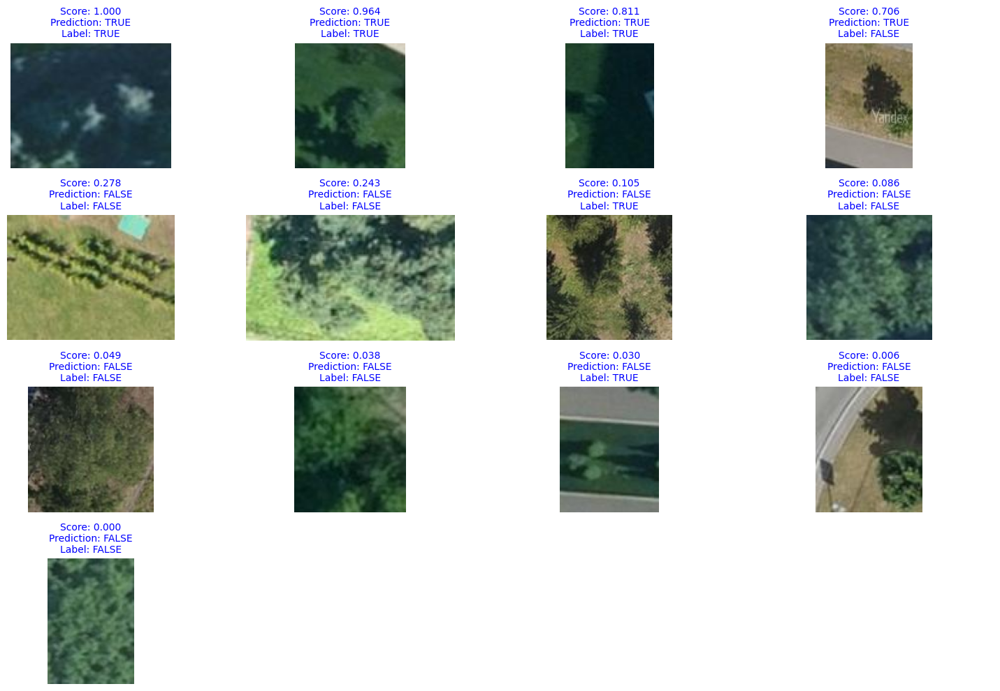

In [63]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

def plot_images_with_scores(images, scores, predictions, labels, num_cols=4, figsize=(15, 10)):
    """
    Plots a grid of images with their corresponding scores and predictions.

    Args:
        images (list of PIL.Image): List of images in PIL format.
        scores (list of float): List of model scores for the positive class.
        predictions (list of int): List of model predictions (e.g., 0 or 1).
        num_cols (int): Number of columns in the plot grid.
        figsize (tuple): Size of the figure.
    """
    num_images = len(images)
    num_rows = (num_images + num_cols - 1) // num_cols  # Calculate the number of rows
    fig, axes = plt.subplots(num_rows, num_cols, figsize=figsize)
    axes = axes.flatten()  # Flatten axes for easy iteration

    for idx, (img, score, pred, label) in enumerate(zip(images, scores, predictions, labels)):
        ax = axes[idx]
        ax.imshow(img)
        ax.axis('off')
        pred = "TRUE" if pred else "FALSE"
        true = "TRUE" if label else "FALSE"
        ax.set_title(f"Score: {score:.3f}\nPrediction: {pred}\nLabel: {true}", fontsize=10, color='blue')
    
    # Hide any extra subplots
    for idx in range(len(images), len(axes)):
        axes[idx].axis('off')

    plt.tight_layout()
    plt.show()


plot_images_with_scores(images, scores, preds, labels)


In [64]:
all_images_df = pd.concat([markup_df[[LABEL_COL, PATH_COL]], labeled_df[[LABEL_COL, PATH_COL]]])
all_images_dataset = ImageClassificationDataset(base_dataframe=all_images_df, transform=train_transform)

/tmp/ipykernel_29202/3411046016.py:1: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



In [65]:
all_images_height_weight = np.array([
    np.array(img).shape[:-1] for img in all_images_dataset._images
])
all_images_height_weight


height_weight_df = pd.DataFrame(data=all_images_height_weight, columns=["Height", "Width"])
height_weight_df["Amount"] = 1

In [66]:
import plotly.express as px



In [67]:
px.scatter(height_weight_df, x="Width", y="Height", marginal_x="box", marginal_y="box", title="Distribution of pairwise (Height, Width) of images (both markup and non-markup)")

In [68]:
counts_df = height_weight_df.groupby(by=["Height", "Width"])["Amount"].agg("count").reset_index()

In [69]:
px.scatter_3d(
    counts_df,
    x="Height",
    y="Width",
    z="Amount",
    color="Amount",
    title="Counts of each (Height & Width) pairs"
)

In [70]:
px.scatter_3d(
    counts_df[counts_df["Amount"] < counts_df["Amount"].max()],
    x="Height",
    y="Width",
    z="Amount",
    color="Amount",
    title="Counts of each (Height & Width) without (128, 128)"
)

In [71]:
counts_df["Amount"].sum()

np.int64(33244)

## Check embeddings of the images

In [72]:
from tqdm import tqdm

In [73]:
embedding_model = model
embedding_model.fc = nn.Identity()

embeddings = []
targets = []
embedding_model.to(DEVICE)



all_images_dataset = ImageClassificationDataset(base_dataframe=all_images_df, transform=test_transform)
loader = DataLoader(all_images_dataset, batch_size=64, prefetch_factor=4, num_workers=12)



for X, y in tqdm(loader, total=len(loader)):
    embeddings.append(
        embedding_model(X.to(DEVICE)).detach().cpu()
    )
    targets.append(y.detach().cpu())


embeddings = torch.concatenate(embeddings, 0).numpy()
embeddings /= np.linalg.norm(embeddings, axis=-1)[:, np.newaxis]

targets = torch.concatenate(targets).numpy()

np.save("embeddings", embeddings)

100%|██████████| 520/520 [00:31<00:00, 16.48it/s]


In [74]:
targets[:201]

array([[ 1.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 1.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 1.],
       [ 1.],
       [ 1.],
       [ 0.],
       [ 1.],
       [ 1.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 1.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 1.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 1.],
       [ 0.],
       [ 1.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 1.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 0.],
       [ 1.],
      

In [75]:
from sklearn.neighbors import KNeighborsClassifier

In [76]:
neighbours_list = [1, 3, 5, 7]
leaves_sizes = [3, 5, 10, 15, 20, 30, 45]


In [77]:
labeled_X, labeled_Y = embeddings[:200], targets[:200].ravel()

In [78]:
all_images_df.head()

,is_conifer,image_path
0,1.0,data/markup/0101000020E6100000FABC6D9C10DC4240...
1,0.0,data/markup/0101000020E6100000A54749CB65CB4240...
2,1.0,data/markup/0101000020E6100000FAEF4A5D75513E40...
3,0.0,data/markup/0101000020E6100000A5557106A6B44240...
4,0.0,data/markup/0101000020E6100000A535CEF231BD4240...


In [79]:
parameters = [[k, leaf_size] for k in neighbours_list for leaf_size in leaves_sizes]
knn_classifiers = [KNeighborsClassifier(n_jobs=-1, n_neighbors=k, algorithm="kd_tree", weights="distance", leaf_size=leaf_size) for k, leaf_size in parameters]
predictions = []

for knn in knn_classifiers:
    knn.fit(labeled_X, labeled_Y)
    predictions.append(knn.predict_proba(embeddings[200:]))



In [80]:
predictions_matric_for_multiple_knns = np.concatenate([p[:, 1][..., None] for p in predictions], 1)

In [81]:
predictions_matric_for_multiple_knns

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [1.        , 1.        , 1.        , ..., 1.        , 1.        ,
        1.        ],
       [0.        , 0.        , 0.        , ..., 0.4435954 , 0.4435954 ,
        0.4435954 ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.13519784, 0.13519784,
        0.13519784],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

Заведем трешхолды предсказаний каждого из классов:

In [82]:
strongly_negative_class_mask = ((predictions_matric_for_multiple_knns < 0.35).sum(1) / predictions_matric_for_multiple_knns.shape[1]) > 0.5
strongly_positive_class_mask = ((predictions_matric_for_multiple_knns > 0.65).sum(1) / predictions_matric_for_multiple_knns.shape[1]) > 0.5

In [83]:
(strongly_negative_class_mask & strongly_positive_class_mask).sum()

np.int64(0)

In [84]:
strongly_positive_class_mask

array([False,  True, False, ..., False, False, False])

In [85]:
strongly_negative_class_mask

array([ True, False, False, ...,  True,  True,  True])

In [86]:
weakly_estimated_class_mask = ~(strongly_positive_class_mask | strongly_negative_class_mask)

In [87]:
estimated_labels = np.empty(weakly_estimated_class_mask.shape[0])
estimated_labels[:] = np.nan

estimated_labels[strongly_negative_class_mask] = 0.0
estimated_labels[strongly_positive_class_mask] = 1.0

In [88]:
all_labels_concatenated = np.concatenate([labeled_Y, estimated_labels])

labels_string_representations = ["Real 1" if x == 1.0 else "Real 0" for x in labeled_Y]

for estimated_label in estimated_labels:
    if estimated_label == 1:
        labels_string_representations.append("Estimated 1")
    elif estimated_label == 0:
        labels_string_representations.append("Estimated 0")
    else:
        labels_string_representations.append("Hard to classify")

## Dimensionality reduction

In [89]:
from sklearn.manifold import TSNE


tsne = TSNE(n_components=2, n_jobs=-1, verbose=True)


encoded = tsne.fit_transform(embeddings, y=None)

np.save("embeddings_tsne", encoded)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 33244 samples in 0.021s...
[t-SNE] Computed neighbors for 33244 samples in 16.966s...
[t-SNE] Computed conditional probabilities for sample 1000 / 33244
[t-SNE] Computed conditional probabilities for sample 2000 / 33244
[t-SNE] Computed conditional probabilities for sample 3000 / 33244
[t-SNE] Computed conditional probabilities for sample 4000 / 33244
[t-SNE] Computed conditional probabilities for sample 5000 / 33244
[t-SNE] Computed conditional probabilities for sample 6000 / 33244
[t-SNE] Computed conditional probabilities for sample 7000 / 33244
[t-SNE] Computed conditional probabilities for sample 8000 / 33244
[t-SNE] Computed conditional probabilities for sample 9000 / 33244
[t-SNE] Computed conditional probabilities for sample 10000 / 33244
[t-SNE] Computed conditional probabilities for sample 11000 / 33244
[t-SNE] Computed conditional probabilities for sample 12000 / 33244
[t-SNE] Computed conditional probabilities for sa

[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.377319
[t-SNE] KL divergence after 1000 iterations: 2.227476


In [90]:
px.scatter(x=encoded[:, 0], y=encoded[:, 1], color=labels_string_representations, hover_data={"index": list(range(len(labels_string_representations)))})

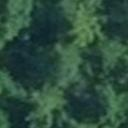

In [91]:
all_images_dataset._images[14102]

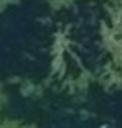

In [92]:
all_images_dataset._images[2970]

In [93]:
from sklearn.cluster import KMeans

In [94]:
clusterization = KMeans(n_clusters=200, init=embeddings[:200])

clusters = clusterization.fit_predict(embeddings)



In [95]:
cluster2label = {i:c.item() for i, c in enumerate(all_images_df[LABEL_COL].values[:200])}

In [96]:
clusters

array([164,   1,  88, ...,  82,  90,  32], dtype=int32)

In [97]:
labeled_clusters = [str(cluster2label[c]) if i >= 200 else ("Original 1" if cluster2label[c] else "Original 0") for i, c in enumerate(clusters)]
labeled_clusters[:500]

['Original 1',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original

In [98]:
px.scatter(x=encoded[:, 0], y=encoded[:, 1], color=clusters)

In [99]:
px.scatter(x=encoded[:1000, 0], y=encoded[:1000, 1], color=labeled_clusters[:1000], hover_data={"index": list(range(len(labeled_clusters[:1000])))})

In [100]:
px.scatter(x=encoded[:, 0], y=encoded[:, 1], color=labeled_clusters, hover_data={"index": list(range(len(labeled_clusters)))})

In [101]:
labeled_clusters

['Original 1',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 1',
 'Original 0',
 'Original 0',
 'Original 0',
 'Original

In [102]:
labels_string_representations

['Real 1',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 0',
 'Real 0',
 'Real 1',
 'Real 1',
 'Real 1',
 'Real 1',
 'Real 1',
 'Real 1',
 'Real 0',
 'Real 0',

In [103]:
labels_enhanced_by_kmeans = labels_string_representations[:200]

for i in range(200, len(labels_string_representations)):
    label_from_knn = labels_string_representations[i]
    label_from_kmeans = labeled_clusters[i]

    if label_from_knn == "Estimated 0" and label_from_kmeans == "0.0":
        labels_enhanced_by_kmeans.append("KNN+KMeans 0")
    elif label_from_knn == "Estimated 1" and label_from_kmeans == "1.0":
        labels_enhanced_by_kmeans.append("KNN+KMeans 1")
    elif label_from_knn == "Estimated 0" and label_from_kmeans == "1.0":
        labels_enhanced_by_kmeans.append("KNN 0 + KMeans 1")
    elif label_from_knn == "Estimated 1" and label_from_kmeans == "0.0":
        labels_enhanced_by_kmeans.append("KNN 1 + KMeans 0")
    else:
        labels_enhanced_by_kmeans.append("Contradiction")

In [104]:
import json

json.dump(labels_enhanced_by_kmeans, fp=open("crowdsource_labels_estimated.json", "w"))

In [105]:
px.scatter(x=encoded[:, 0], y=encoded[:, 1], color=labels_enhanced_by_kmeans, hover_data={"index": list(range(len(labels_enhanced_by_kmeans)))})

In [106]:
contradicted_indices = list(filter(lambda index: any([(value := labels_enhanced_by_kmeans[index]) == "KNN 0 + KMeans 1", value == "KNN 2 + KMeans 0", value == "Contradiction"]), range(len(labels_enhanced_by_kmeans))))

In [108]:
strongly_estimated_indices = [i for i in range(len(labels_enhanced_by_kmeans)) if i not in contradicted_indices and i >= 200]  # remove labeled indices

Возьмем среди них такие, у которых среди соседей есть неопределенные

In [109]:
knn = KNeighborsClassifier(n_jobs=-1, n_neighbors=7, algorithm="kd_tree", weights="distance")
knn.fit(embeddings, np.ones_like(targets))

/home/fvelikon/miniconda3/envs/cv_week_hw/lib/python3.10/site-packages/sklearn/neighbors/_classification.py:238: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



KNeighborsClassifier(algorithm='kd_tree', n_jobs=-1, n_neighbors=7,
                     weights='distance')

In [110]:
_distances, neighbours = knn.kneighbors(embeddings[strongly_estimated_indices])
neighbours

array([[  200,  5306, 27651, ..., 15500, 30833, 19554],
       [  201,  9105, 29853, ..., 12594, 30513, 13994],
       [  203, 27218, 30881, ..., 20556, 13260, 32307],
       ...,
       [33241,  6663, 13292, ...,   699, 16718, 22977],
       [33242,  3042, 14549, ...,  9070,  9797, 22170],
       [33243,  7192, 15020, ...,  3536, 22581,  4738]])

In [111]:
contradicted_indices_vectorized = np.array(contradicted_indices)[None, ...]

In [112]:
additional_indices_mask = (neighbours[..., None] == contradicted_indices_vectorized).any((1, 2))


strongly_estimated_indices_containing_contradicted_indices = [i for i, f in zip(strongly_estimated_indices, additional_indices_mask) if f]


In [113]:
indices_to_refine_further = contradicted_indices + strongly_estimated_indices_containing_contradicted_indices

In [114]:
website_root = "https://new-projects-team-public.s3.yandex.net/shad_homework_3/"


images_df_to_refine = all_images_df.iloc[indices_to_refine_further].copy()
images_df_to_refine[URL_COL] = images_df_to_refine[PATH_COL].apply(lambda x: website_root + x.split('/')[-1])
images_df_to_refine.head()

,is_conifer,image_path,downloadUrl
2,NaN,data/no_markup/0101000020E6100000C9303D4DA5D64...,https://new-projects-team-public.s3.yandex.net...
5,NaN,data/no_markup/0101000020E6100000A9057D897B6A3...,https://new-projects-team-public.s3.yandex.net...
9,NaN,data/no_markup/0101000020E6100000E3CC3520D0713...,https://new-projects-team-public.s3.yandex.net...
10,NaN,data/no_markup/0101000020E6100000DDF2E2DBB3CF4...,https://new-projects-team-public.s3.yandex.net...
11,NaN,data/no_markup/0101000020E6100000E5F24F0BC6B14...,https://new-projects-team-public.s3.yandex.net...


In [115]:
images_df_to_refine[URL_COL].reset_index(drop=True).to_csv("images_with_contradictions.csv")

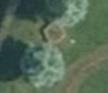

In [116]:
all_images_dataset._images[83]

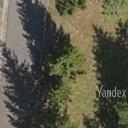

In [117]:
all_images_dataset._images[245]

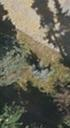

In [118]:
all_images_dataset._images[875]

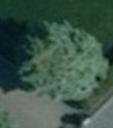

In [119]:
all_images_dataset._images[201]

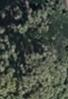

In [120]:
all_images_dataset._images[31]

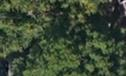

In [121]:
all_images_dataset._images[269] 

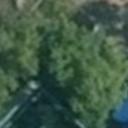

In [122]:
all_images_dataset._images[238] 

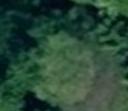

In [123]:
all_images_dataset._images[344] 

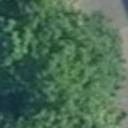

In [124]:
all_images_dataset._images[66]



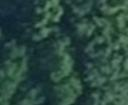

In [125]:
all_images_dataset._images[43] 

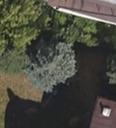

In [126]:
all_images_dataset._images[151] 

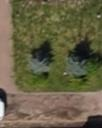

In [127]:
all_images_dataset._images[2] 

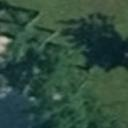

In [128]:
all_images_dataset._images[17] 

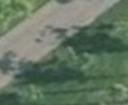

In [129]:
all_images_dataset._images[57] 

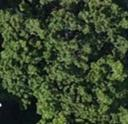

In [130]:
all_images_dataset._images[81]

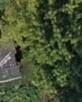

In [131]:
all_images_dataset._images[24922]

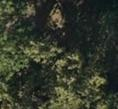

In [132]:
all_images_dataset._images[5552]

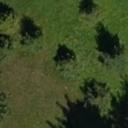

In [133]:
all_images_dataset._images[11527]

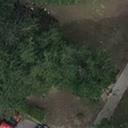

In [134]:
all_images_dataset._images[69]

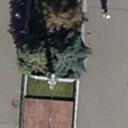

In [135]:
all_images_dataset._images[175]

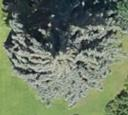

In [136]:
all_images_dataset._images[23255]